### Summary of work done from October to 2nd December 2020

Start by creating a large dataframe with all the runs in that were completed using these jupyter notebook templates

1. Get file list

In [75]:
from pathlib import Path
saveFiles = [pth for pth in Path.cwd().iterdir()
            if pth.suffix == '.json']

2. iterate through the files and build a dataframe containing everything including the max current on a pin and a slice the centre of the array plate

In [76]:
import pandas as pd
df = pd.DataFrame()
for file in saveFiles:
    runDF = pd.read_json(file)
    df = pd.concat([df,runDF], sort=False)
df = df.reset_index(drop = True)

dates = []
times = []
for time in df.time:
    dates.append(int(str(time)[:6]))
    times.append(int(str(time)[6:]))

df = df.drop('time', axis = 1)
df.insert(0, 'time', times)
df.insert(0, 'date', dates)
df.head()
# df[df.date == 201112]

,date,time,pressure,Vbias,Ibias,Varc,Iarc,Vext,Iext,Ibase,currents,note,Ve1,Ie1,Ve2,Ie2,Ipfs_tube,Vpfs_tube,Vtube,Itube
0,201112,160609,0.00019,150,24.0,80.0,1.50,0.0,10.0,0.980,"[[0.0007829, 0.0012779999999999998, 0.001594, ...",Put something useful here.,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,201112,160737,0.00018,200,26.0,80.0,1.54,0.0,10.0,1.067,"[[0.0008106, 0.001322, 0.0017259999999999999, ...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,201112,160822,0.00018,250,28.7,80.0,1.57,0.0,10.0,1.094,"[[0.0008221, 0.0013189999999999999, 0.00173899...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,201112,160941,0.00018,100,18.7,80.0,1.60,0.0,0.0,0.321,"[[0.00047599999999999997, 0.000785999999999999...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,201112,161159,0.00018,100,15.6,80.0,1.67,50.0,0.0,0.207,"[[0.0004188, 0.0006772, -9.366e-06, -0.0008078...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


3. Find IpinMax in all results and add them as a column and add a slice of currents to each central row so we can plot all the currents.

In [78]:
import numpy as np
IpinMax = []
currentSlice = []
for currents in df.currents:
    IpinMax.append(np.max(currents))
    middleRow = len(currents) // 2
    currentSlice.append(currents[middleRow])
df.insert(2, 'IpinMax', IpinMax)
df.insert(3, 'CurrentSlice', currentSlice)

In [53]:
df.head()

,date,time,IpinMax,CurrentSlice,pressure,Vbias,Ibias,Varc,Iarc,Vext,...,currents,note,Ve1,Ie1,Ve2,Ie2,Ipfs_tube,Vpfs_tube,Vtube,Itube
0,201112,160609,0.003789,"[0.002535, 0.0031509999999999997, 0.0035900000...",0.00019,150,24.0,80.0,1.50,0.0,...,"[[0.0007829, 0.0012779999999999998, 0.001594, ...",Put something useful here.,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,201112,160737,0.004355,"[0.002598, 0.0034600000000000004, 0.0041, 0.00...",0.00018,200,26.0,80.0,1.54,0.0,...,"[[0.0008106, 0.001322, 0.0017259999999999999, ...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,201112,160822,0.004483,"[0.002479, 0.003482, 0.004287, 0.004471, 0.004...",0.00018,250,28.7,80.0,1.57,0.0,...,"[[0.0008221, 0.0013189999999999999, 0.00173899...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,201112,160941,0.002313,"[0.001802, 0.001947, 0.0015249999999999999, 0....",0.00018,100,18.7,80.0,1.60,0.0,...,"[[0.00047599999999999997, 0.000785999999999999...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,201112,161159,0.002060,"[0.0015400000000000001, 0.001477, 0.0009442, 0...",0.00018,100,15.6,80.0,1.67,50.0,...,"[[0.0004188, 0.0006772, -9.366e-06, -0.0008078...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Find the highest central pin currents

In [79]:
df.sort_values(by=['IpinMax'], ascending=False).head(10)

,date,time,IpinMax,CurrentSlice,pressure,Vbias,Ibias,Varc,Iarc,Vext,...,currents,note,Ve1,Ie1,Ve2,Ie2,Ipfs_tube,Vpfs_tube,Vtube,Itube
124,201201,151854,0.4474,"[0.19240000000000002, 0.3257, 0.4153, 0.446700...",0.00030,125,0.873,70.8,6.12,NaN,...,"[[0.01263, 0.0753, 0.1729, 0.2048, 0.1613, 0.0...",Tube grounded.,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
159,201202,160939,0.4441,"[0.1983, 0.326, 0.4096, 0.4413, 0.4441, 0.3305...",0.00024,125,1.030,71.0,5.05,NaN,...,"[[0.01485, 0.07525000000000001, 0.1892, 0.2251...",Tube removed.,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
156,201202,141555,0.4433,"[0.192, 0.32120000000000004, 0.4097, 0.439, 0....",0.00030,125,0.657,69.1,6.07,NaN,...,"[[0.01314, 0.07563, 0.1699, 0.2016, 0.1584, 0....",Tube referenced to PFS Vbias.,NaN,NaN,NaN,NaN,NaN,NaN,93.0,0.19
162,201202,161745,0.4391,"[0.1923, 0.3235, 0.40490000000000004, 0.4374, ...",0.00024,125,0.983,73.6,5.03,NaN,...,"[[0.014910000000000001, 0.07352, 0.18710000000...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
158,201202,141833,0.4380,"[0.19160000000000002, 0.32280000000000003, 0.4...",0.00030,125,0.670,69.1,6.08,NaN,...,"[[0.012770000000000002, 0.07595, 0.1721, 0.203...",Tube referenced to PFS Vbias.,NaN,NaN,NaN,NaN,NaN,NaN,300.0,0.24
102,201201,122708,0.4071,"[0.1842, 0.298, 0.3796, 0.4037, 0.4071, 0.3313...",0.00040,125,0.548,70.1,6.08,NaN,...,"[[0.008801, 0.05398000000000001, 0.1312, 0.157...",Tube floating. Now increasing current at max p...,NaN,NaN,NaN,NaN,NaN,45.64,NaN,NaN
161,201202,161442,0.3651,"[0.1573, 0.26890000000000003, 0.3373, 0.365100...",0.00027,125,0.825,75.0,3.94,NaN,...,"[[0.013410000000000002, 0.06365000000000001, 0...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
101,201201,122355,0.3574,"[0.1628, 0.2649, 0.3355, 0.356, 0.3574, 0.2896...",0.00040,125,0.486,70.1,5.38,NaN,...,"[[0.006875999999999999, 0.0432, 0.111800000000...",Tube floating.,NaN,NaN,NaN,NaN,NaN,45.48,NaN,NaN
66,201130,163144,0.3550,"[0.1562, 0.256, 0.33030000000000004, 0.3535000...",0.00050,125,457.000,70.3,5.10,NaN,...,"[[0.007133, 0.042910000000000004, 0.1118000000...",Tube now floating. Bed current takes ages to e...,NaN,NaN,NaN,NaN,NaN,42.00,NaN,NaN
122,201201,150147,0.3476,"[0.16590000000000002, 0.2654, 0.3304, 0.3476, ...",0.00024,125,0.715,69.8,5.21,NaN,...,"[[0.007534, 0.04225, 0.11180000000000001, 0.13...",Tube grounded.,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


4. For each day, plot all the current slices

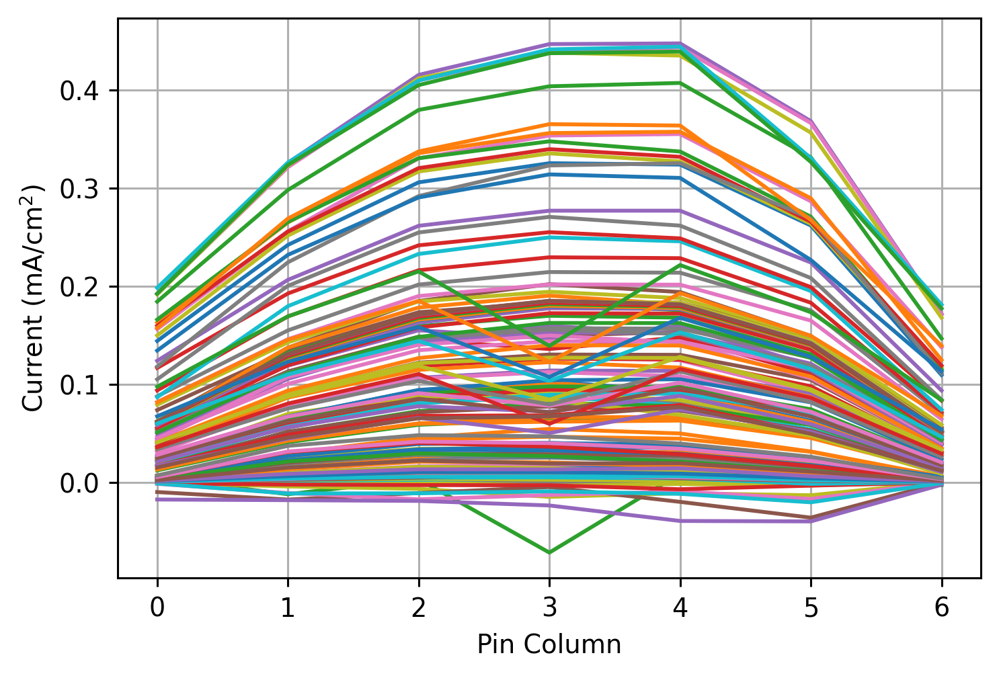

In [80]:
from scipy.interpolate import CubicSpline
import matplotlib.pyplot as plt
plt.figure(dpi=276, figsize=(6,4))
for slice in df.CurrentSlice:
    if len(slice) == 5:
        offset = 1
    else:
        offset = 0
#         slice = slice / np.max(np.abs(slice))
    x = np.arange(offset, offset+len(slice))
    cs = CubicSpline(x, slice)
    xs = np.linspace(offset, offset+len(slice)-1, 21)
    plt.plot(x, slice)
#     plt.plot(xs, cs(xs))
plt.xlabel('Pin Column')
plt.ylabel('Current (mA/cm$^2$)')
plt.grid()
plt.show()

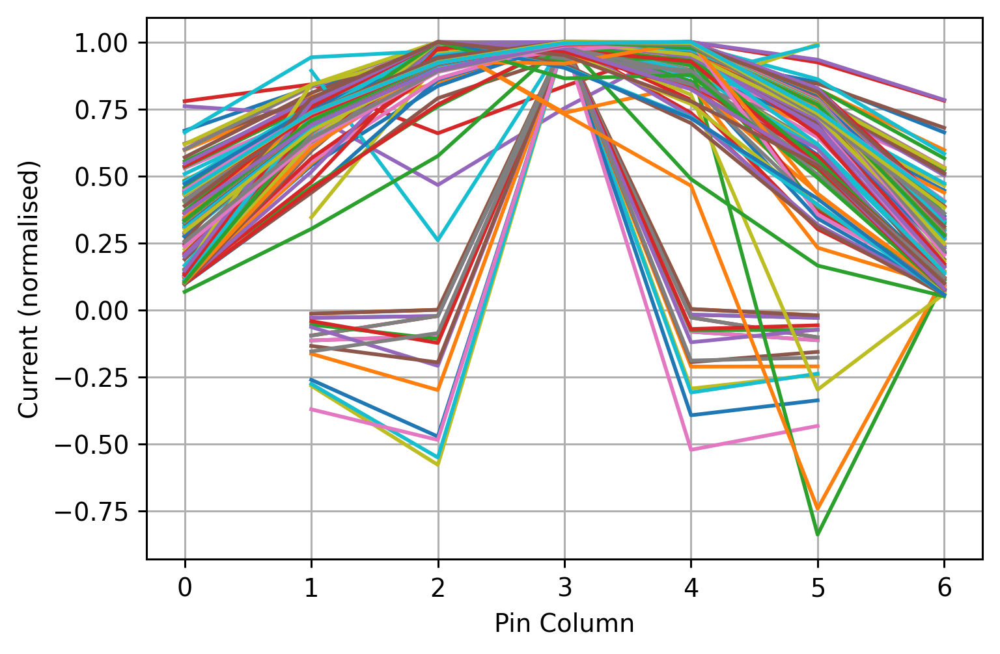

In [7]:
from scipy.interpolate import CubicSpline
import matplotlib.pyplot as plt
plt.figure(dpi=276, figsize=(6,4))
for slice in df.CurrentSlice:
    # only plot results where the max current is positive
    if np.max(slice) >= np.max(np.abs(slice)):
        if len(slice) == 5:
            offset = 1
        else:
            offset = 0
        slice = slice / np.max(np.abs(slice))
        x = np.arange(offset, offset+len(slice))
        cs = CubicSpline(x, slice)
        xs = np.linspace(offset, offset+len(slice)-1, 21)
        plt.plot(x, slice)
#     plt.plot(xs, cs(xs))
plt.xlabel('Pin Column')
plt.ylabel('Current (normalised)')
plt.grid()
plt.show()

Now go through all the results and plot them day by day so we can see what happened. 

In [8]:
df.date.unique()

array([201112, 201117, 201123, 201124, 201130, 201201, 201202],
      dtype=int64)

### 12th November

Only an extraction cylinder element was used. Vext was set to be positive and this was causing the Vbias supply to get increasingly pulled up to higher positive voltages. This is in consequence of the supply not being able to handle negative currents (electrons leaving the positive terminal which in this case is the PFS body as a whole).

Largest current on central pin was achieved with largest Vext (and therefore Vbias). Not really worth looking at since max value is very low. 2 mA of ions total hit the array plate.

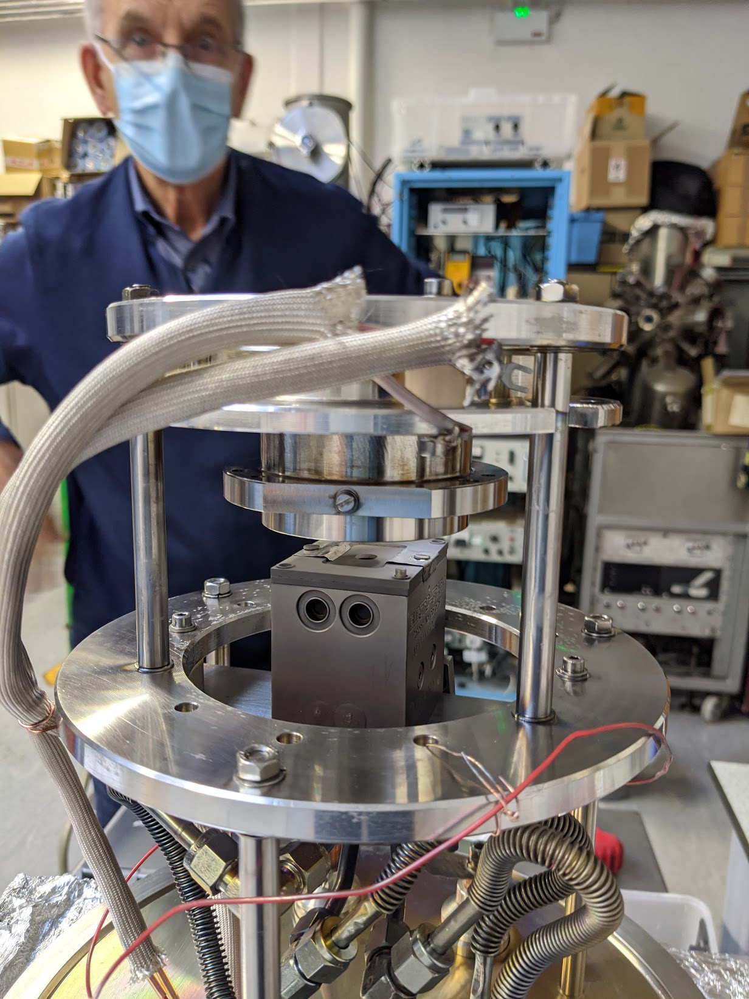

In [13]:
df[df.date == 201112].sort_values(by=['IpinMax'], ascending=False).head()

,date,time,IpinMax,CurrentSlice,pressure,Vbias,Ibias,Varc,Iarc,Vext,...,currents,note,Ve1,Ie1,Ve2,Ie2,Ipfs_tube,Vpfs_tube,Vtube,Itube
12,201112,162503,0.008330,"[0.004443, 0.00636, 0.008036, 0.00833, 0.00795...",0.00055,400,-6.8,80.0,1.94,396.0,...,"[[0.0015949999999999998, 0.002525, 0.003309, 0...",Now trying to up the pressure. Vbias gets pull...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
13,201112,162626,0.007149,"[0.0038339999999999997, 0.00553, 0.006977, 0.0...",0.00060,355,-6.7,80.0,2.03,350.0,...,"[[0.001338, 0.0021479999999999997, 0.002820999...",Vbias gets pulled up to 400 V,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
14,201112,162814,0.006022,"[0.003289, 0.004755, 0.005934999999999999, 0.0...",0.00060,305,-6.7,80.0,2.08,300.0,...,"[[0.001099, 0.001803, 0.0023669999999999997, 0...",Vbias gets pulled up to 305 V,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15,201112,162926,0.005089,"[0.002898, 0.00412, 0.005039, 0.005089, 0.0047...",0.00060,254,-7.0,80.0,2.19,250.0,...,"[[0.0009333, 0.0015639999999999999, 0.002051, ...",Vbias gets pulled up,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,201112,161950,0.004566,"[0.002317, 0.003341, 0.004173, 0.004566, 0.004...",0.00019,314,-6.8,80.0,1.87,300.0,...,"[[0.0008234, 0.001344, 0.001759, 0.001969, 0.0...",Vbias gets pulled up to 314 V,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### 17th November

More of the same to demonstrate to Jaap. Not much worth looking at. If you turn the arc current up, you can get a decent amount of current on the arrayplate. There is a slight focussing perhaps.

In [17]:
df_17Nov = df[df.date == 201117].sort_values(by=['IpinMax'], ascending=False).head()
df_17Nov

,date,time,IpinMax,CurrentSlice,pressure,Vbias,Ibias,Varc,Iarc,Vext,...,currents,note,Ve1,Ie1,Ve2,Ie2,Ipfs_tube,Vpfs_tube,Vtube,Itube
24,201117,111638,0.1594,"[0.058820000000000004, 0.11900000000000001, 0....",0.00014,120,330.00,77.7,4.35,50.0,...,"[[0.001295, 0.009613, 0.04159, 0.0529600000000...",Increasing Vext only,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25,201117,111717,0.1531,"[0.05498, 0.1131, 0.14850000000000002, 0.1496,...",0.00014,120,288.00,77.7,4.35,60.0,...,"[[0.0012900000000000001, 0.008786, 0.03848, 0....",Increasing Vext only,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
23,201117,111448,0.1478,"[0.053250000000000006, 0.1102, 0.1454, 0.1359,...",0.00014,120,365.00,77.7,4.35,33.0,...,"[[0.0012209999999999999, 0.008447999999999999,...",DC fail on Vext. Vext is being pulled up to 33...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
26,201117,111757,0.1285,"[0.041530000000000004, 0.08923, 0.1218, 0.1285...",0.00014,120,193.00,77.7,4.35,70.0,...,"[[0.0011459999999999999, 0.006286, 0.028280000...",Increasing Vext only,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31,201117,112405,0.1050,"[0.020220000000000002, 0.06621, 0.092860000000...",0.00014,162,-0.08,77.7,4.38,120.0,...,"[[0.0013800000000000002, 0.0028569999999999997...",Increasing Vext only.,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


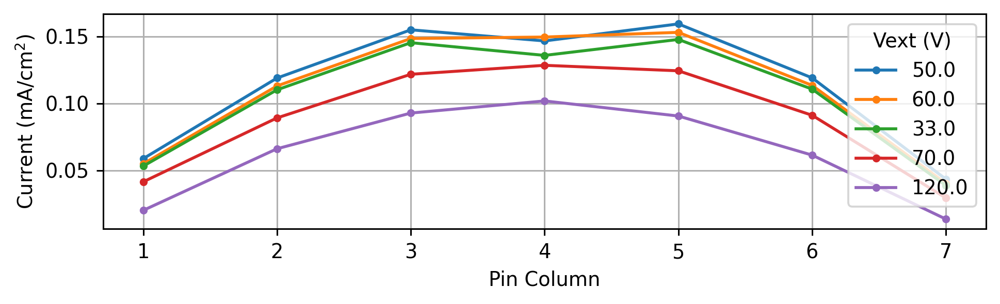

In [29]:
import matplotlib.pyplot as plt
plt.figure(dpi=276, figsize=(8,2))
for i, slice in enumerate(df_17Nov.CurrentSlice):
    if len(slice) == 5:
        offset = 2
    else:
        offset = 1
#         slice = slice / np.max(np.abs(slice))
    x = np.arange(offset, offset+len(slice))
#     cs = CubicSpline(x, slice)
#     xs = np.linspace(offset, offset+len(slice)-1, 21)
    label = df_17Nov.iloc[i].Vext
    plt.plot(x, slice, '.-', label = label)
#     plt.plot(xs, cs(xs))
plt.xlabel('Pin Column')
plt.ylabel('Current (mA/cm$^2$)')
plt.legend(title = 'Vext (V)')
plt.grid()
plt.show()

### 23rd November

Testing with the full lens stack. At most we can extract 4 mA and get 7 microAmps/cm$^2$ on the central pin. Very sharply focused though. At least half of the current leaving the PFS ends up on the electrodes though.

This does show that the lens can focus the beam but it is not a viable way to run the source because there is ~100 less current focused onto the central pin compared to just flooding the region.

We used a 'shaped' stub on the end of the PFS to simulate a Pierce Electrode.
* Even at Iarc = 6 A, only get 13 mA out. 
* Nearly neutral arrayplate but secondaries from all the ions hitting the extractor and E1 are then hitting the array plate.
* Increasing pressure makes it worse as well as resulting in breakdown.

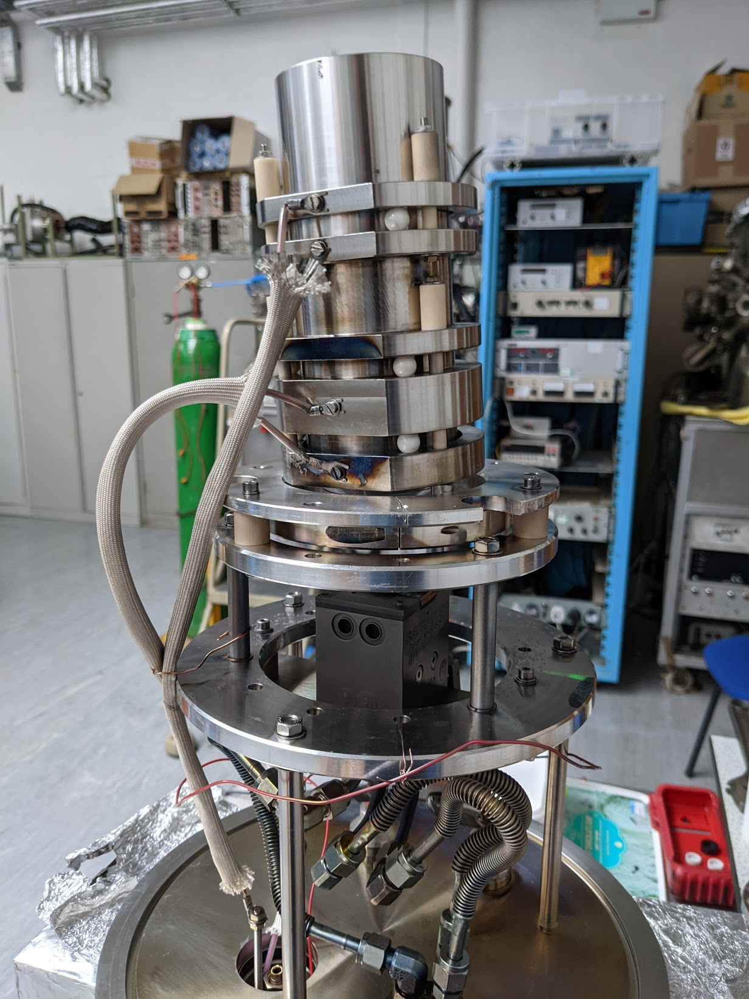

In [31]:
df_23Nov = df[df.date == 201123].sort_values(by=['IpinMax'], ascending=False)
df_23Nov

,date,time,IpinMax,CurrentSlice,pressure,Vbias,Ibias,Varc,Iarc,Vext,...,currents,note,Ve1,Ie1,Ve2,Ie2,Ipfs_tube,Vpfs_tube,Vtube,Itube
45,201123,152657,0.007047,"[-0.0002967, -0.0008703999999999999, 0.0070469...",0.000130,125,4.2,72.5,1.70,-10050.0,...,"[[-0.000758, -0.0004499, -0.000446999999999999...",,-5509.0,-1.73,-500.0,0.0,NaN,NaN,NaN,NaN
32,201123,151127,0.006938,"[-0.0002063, -0.0001608, 0.006938, -0.0001247,...",0.000090,125,2.8,72.5,1.40,-9200.0,...,"[[-0.0003191, -0.0002438, -0.00022899999999999...",,-2700.0,-1.62,-250.0,0.0,NaN,NaN,NaN,NaN
36,201123,151127,0.006938,"[-0.0002063, -0.0001608, 0.006938, -0.0001247,...",0.000090,125,2.8,72.5,1.40,-9200.0,...,"[[-0.0003191, -0.0002438, -0.00022899999999999...",,-2700.0,-1.62,-250.0,0.0,NaN,NaN,NaN,NaN
44,201123,152528,0.006703,"[-0.0003683, -0.0007262999999999999, 0.006703,...",0.000130,125,4.1,72.5,1.70,-9930.0,...,"[[-0.0007339, -0.0004786, -0.0004432, -0.00046...",,-4843.0,-1.94,-500.0,0.0,NaN,NaN,NaN,NaN
46,201123,153337,0.005179,"[-0.0003321, -0.0010819999999999998, 0.005179,...",0.000130,125,4.2,72.5,1.78,-10020.0,...,"[[-0.0007607, -0.0004788, -0.0004572, -0.00049...",,-6509.0,-1.58,-500.0,0.0,NaN,NaN,NaN,NaN
37,201123,151312,0.005032,"[-7.214000000000001e-05, 1.6e-06, 0.005032, 1....",0.000065,125,2.2,72.5,1.38,-9030.0,...,"[[-0.0001764, -0.0001348, -0.0001296, -0.00014...",,-2700.0,-0.79,-250.0,0.0,NaN,NaN,NaN,NaN
33,201123,151312,0.005032,"[-7.214000000000001e-05, 1.6e-06, 0.005032, 1....",0.000065,125,2.2,72.5,1.38,-9030.0,...,"[[-0.0001764, -0.0001348, -0.0001296, -0.00014...",,-2700.0,-0.79,-250.0,0.0,NaN,NaN,NaN,NaN
47,201123,153504,0.004238,"[-0.0005698, -0.0008313, 0.004238, -0.00082739...",0.000130,125,4.3,72.5,1.81,-10020.0,...,"[[-0.0006487, -0.0006192, -0.0006473, -0.00060...",,-3885.0,-2.52,-500.0,0.0,NaN,NaN,NaN,NaN
34,201123,151417,0.003317,"[-0.0003787, -0.0003251, 0.0033169999999999996...",0.000130,125,3.9,72.5,1.59,-9030.0,...,"[[-0.0005273, -0.00042219999999999996, -0.0003...",,-2700.0,-3.11,-250.0,0.0,NaN,NaN,NaN,NaN
38,201123,151417,0.003317,"[-0.0003787, -0.0003251, 0.0033169999999999996...",0.000130,125,3.9,72.5,1.59,-9030.0,...,"[[-0.0005273, -0.00042219999999999996, -0.0003...",,-2700.0,-3.11,-250.0,0.0,NaN,NaN,NaN,NaN


In [73]:
df_23Nov.iloc[0]

date                                                       201123
time                                                       152657
IpinMax                                                  0.007047
CurrentSlice    [-0.0002967, -0.0008703999999999999, 0.0070469...
pressure                                                  0.00013
Vbias                                                         125
Ibias                                                         4.2
Varc                                                         72.5
Iarc                                                          1.7
Vext                                                       -10050
Iext                                                          0.6
Ibase                                                      -0.029
currents        [[-0.000758, -0.0004499, -0.000446999999999999...
note                                                             
Ve1                                                         -5509
Ie1       

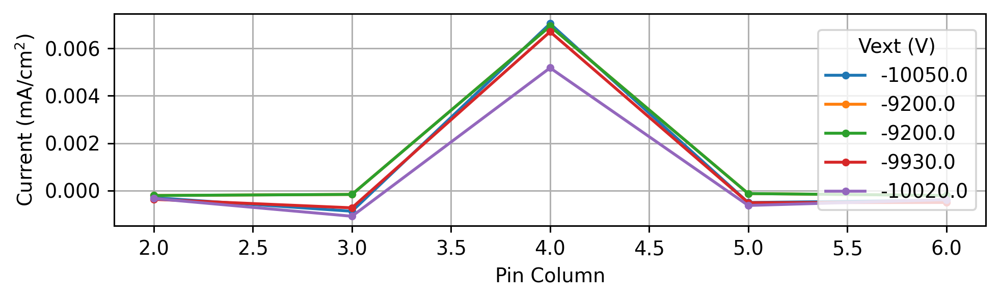

In [35]:
import matplotlib.pyplot as plt
plt.figure(dpi=276, figsize=(8,2))
for i, slice in enumerate(df_23Nov.head().CurrentSlice):
    if len(slice) == 5:
        offset = 2
    else:
        offset = 1
#         slice = slice / np.max(np.abs(slice))
    x = np.arange(offset, offset+len(slice))
#     cs = CubicSpline(x, slice)
#     xs = np.linspace(offset, offset+len(slice)-1, 21)
    label = df_23Nov.iloc[i].Vext
    plt.plot(x, slice, '.-', label = label)
#     plt.plot(xs, cs(xs))
plt.xlabel('Pin Column')
plt.ylabel('Current (mA/cm$^2$)')
plt.legend(title = 'Vext (V)', loc='right')
plt.grid()
plt.show()

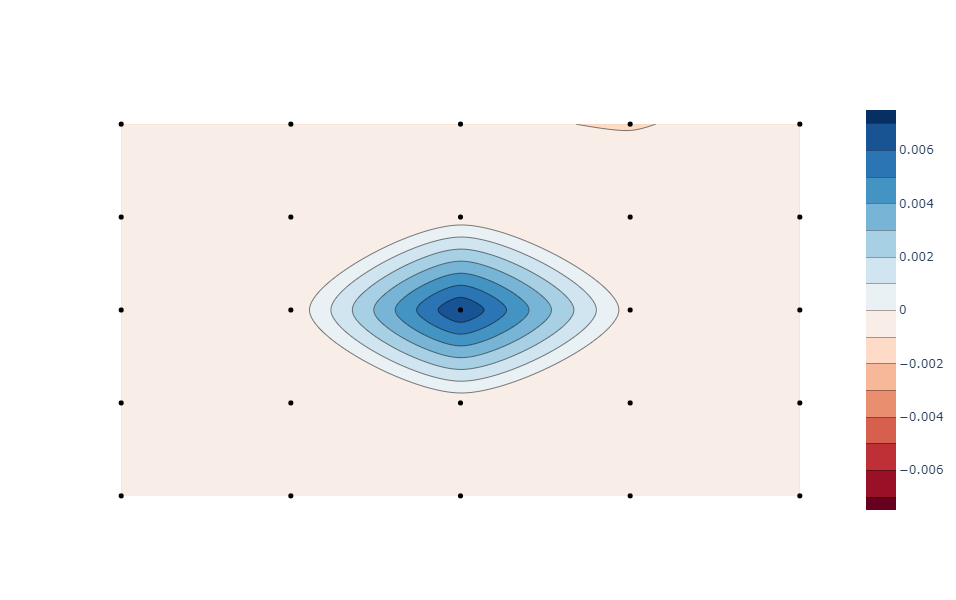

In [36]:
import ArrayPlateLogger as apl 
currents = df_23Nov.iloc[0].currents
apl.plotI(currents)

At this point, we abandoned the full lens stack and extraction system because whenever we apply extraction field, we prevent the ions escaping the PFS.

### 24th November

* Removed the Pierce Electrode
* Replaced it with a grid

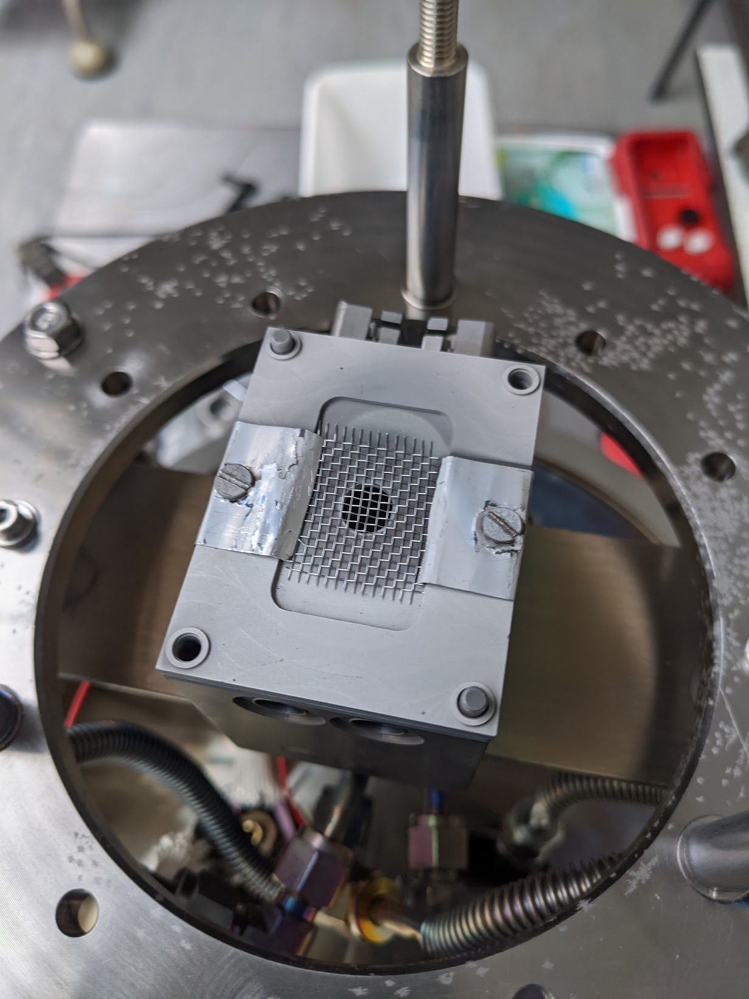

**Result:**
* Everything hits the extractor.
* Only get electrons hitting the arrayplate whatever we do.

In [37]:
df_24Nov = df[df.date == 201124].sort_values(by=['IpinMax'], ascending=False)
df_24Nov

,date,time,IpinMax,CurrentSlice,pressure,Vbias,Ibias,Varc,Iarc,Vext,...,currents,note,Ve1,Ie1,Ve2,Ie2,Ipfs_tube,Vpfs_tube,Vtube,Itube
54,201124,142044,-0.000065,"[-0.0001494, -0.00025309999999999997, -0.00030...",0.00013,120,21.6,80.0,3.50,-6000.0,...,"[[-6.499e-05, -8.875e-05, -0.0001223, -0.00013...",,-1353.0,-0.7,0.0,0.0,NaN,NaN,NaN,NaN
52,201124,141550,-0.000079,"[-0.0001939, -0.0003503, -0.0004612, -0.000513...",0.00013,120,29.4,80.0,4.17,-7120.0,...,"[[-7.882000000000001e-05, -0.0001108, -0.00016...",,-1353.0,-0.5,0.0,0.0,NaN,NaN,NaN,NaN
53,201124,141922,-0.000081,"[-0.000204, -0.0004384, -0.0005411999999999999...",0.00013,120,23.6,80.0,3.50,-7120.0,...,"[[-8.083000000000001e-05, -0.0001164, -0.00019...",,-1353.0,-1.1,0.0,0.0,NaN,NaN,NaN,NaN


### 25th November

* Removed the lens stack and extractor
* Installed ceramic tube to act as funnel

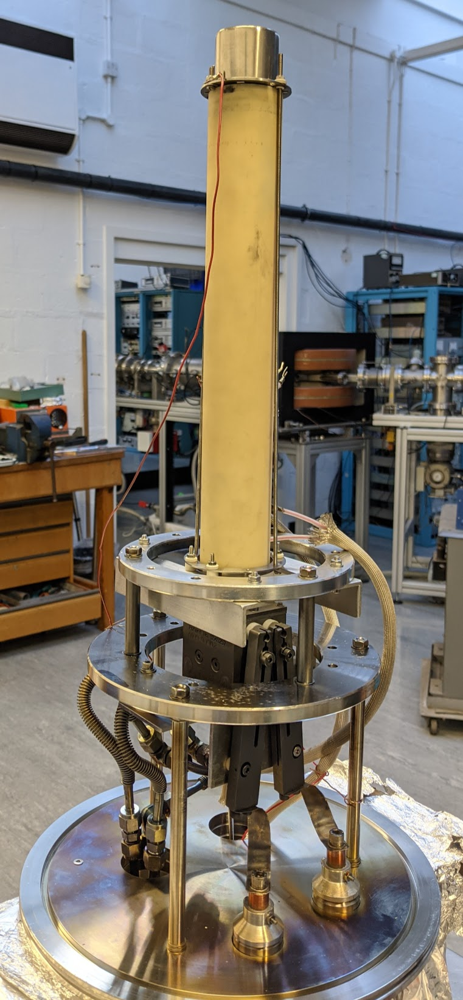

**Results:**
* Does not result in an ion beam. The tube charges up on long time scale so is not controllable or very repeatable.
* Hardly worth showing results.
* So poor and unrepeatable, we did save any readings.

### 30th November

* Replaced the ceramic tube with a metal 4.5" Conflat straight section ~20 cm long.
* Mounted 16 mm from the PFS.
* Tube floating. Gets connected to the PFS by ion/electron current.

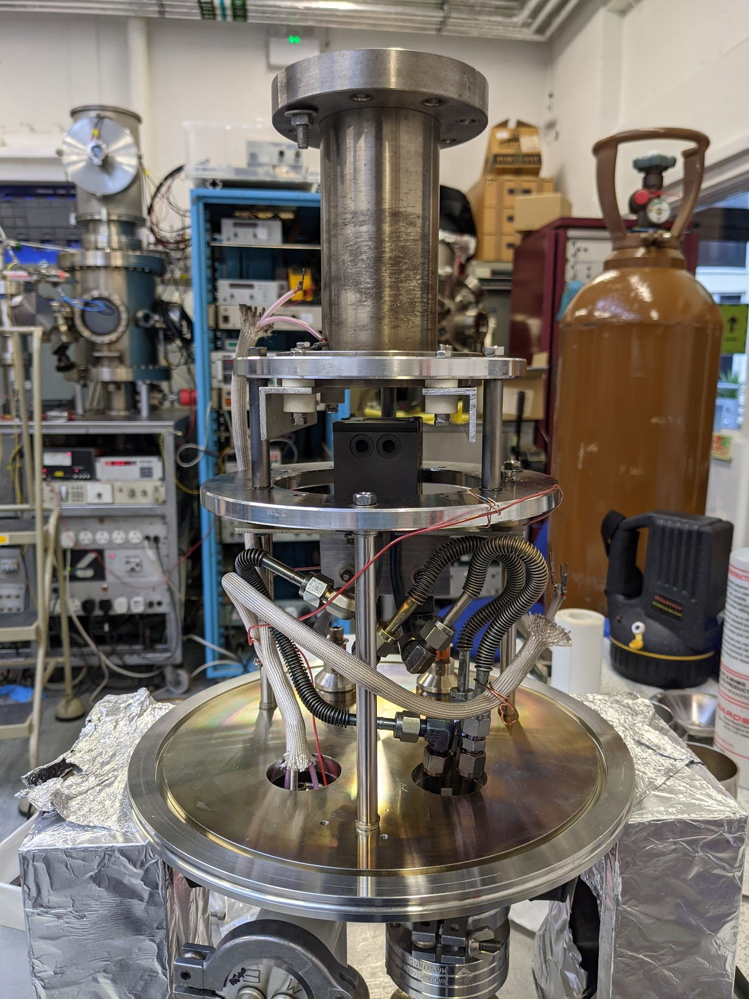

**Results**
* Can get large current but it's no better than a naked PFS.

In [56]:
df_30Nov = df[df.date == 201130].sort_values(by=['IpinMax'], ascending=False)
df_30Nov.head()

,date,time,IpinMax,CurrentSlice,pressure,Vbias,Ibias,Varc,Iarc,Vext,...,currents,note,Ve1,Ie1,Ve2,Ie2,Ipfs_tube,Vpfs_tube,Vtube,Itube
66,201130,163144,0.35500,"[0.1562, 0.256, 0.33030000000000004, 0.3535000...",0.0005,125,457.0,70.3,5.10,NaN,...,"[[0.007133, 0.042910000000000004, 0.1118000000...",Tube now floating. Bed current takes ages to e...,NaN,NaN,NaN,NaN,NaN,42.0,NaN,NaN
65,201130,162412,0.20200,"[0.06196000000000001, 0.1373, 0.1849, 0.202, 0...",0.0002,125,295.0,70.6,5.25,NaN,...,"[[0.001602, 0.011630000000000001, 0.0483800000...",Tube now floating. Bed current takes ages to e...,NaN,NaN,NaN,NaN,NaN,51.0,NaN,NaN
64,201130,162041,0.15960,"[0.04426, 0.10550000000000001, 0.1444, 0.15960...",0.0002,125,225.0,70.6,4.14,NaN,...,"[[0.0013729999999999999, 0.0072900000000000005...",Tube now floating. Bed current takes ages to e...,NaN,NaN,NaN,NaN,NaN,51.0,NaN,NaN
63,201130,161806,0.09490,"[0.02144, 0.06051000000000001, 0.08508, 0.0949...",0.0002,125,125.5,70.8,2.93,NaN,...,"[[0.0010400000000000001, 0.003387, 0.01623, 0....",Tube now floating. Bed current takes ages to e...,NaN,NaN,NaN,NaN,NaN,52.0,NaN,NaN
62,201130,161625,0.08127,"[0.01676, 0.05127, 0.07263, 0.0812700000000000...",0.0002,125,106.5,70.8,2.24,NaN,...,"[[0.0009801, 0.002693, 0.012400000000000001, 0...",Tube now floating. Bed current takes ages to e...,NaN,NaN,NaN,NaN,NaN,52.0,NaN,NaN


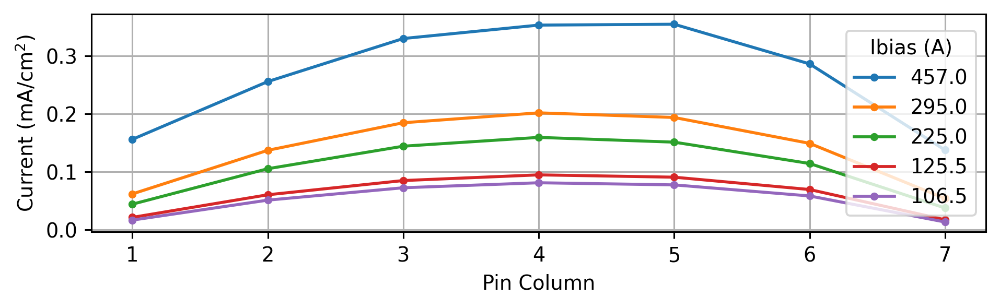

In [70]:
import matplotlib.pyplot as plt
plt.figure(dpi=276, figsize=(8,2))
for i, slice in enumerate(df_30Nov.head().CurrentSlice):
    if len(slice) == 5:
        offset = 2
    else:
        offset = 1
    x = np.arange(offset, offset+len(slice))
    label = df_30Nov.iloc[i].Ibias
    plt.plot(x, slice, '.-', label = label)
plt.xlabel('Pin Column')
plt.ylabel('Current (mA/cm$^2$)')
plt.legend(title = 'Ibias (A)', loc='right')
plt.grid()
plt.show()

In [58]:
df_30Nov.head().iloc[0]

date                                                       201130
time                                                       163144
IpinMax                                                     0.355
CurrentSlice    [0.1562, 0.256, 0.33030000000000004, 0.3535000...
pressure                                                   0.0005
Vbias                                                         125
Ibias                                                         457
Varc                                                         70.3
Iarc                                                          5.1
Vext                                                          NaN
Iext                                                          NaN
Ibase                                                       12.66
currents        [[0.007133, 0.042910000000000004, 0.1118000000...
note            Tube now floating. Bed current takes ages to e...
Ve1                                                           NaN
Ie1       

### 1st December

* Tried both tube floating and grounded. See 
* Get high currents
* No focus.

In [66]:
df_01Dec = df[df.date == 201201].sort_values(by=['IpinMax'], ascending=False)
df_01Dec

,date,time,IpinMax,CurrentSlice,pressure,Vbias,Ibias,Varc,Iarc,Vext,...,currents,note,Ve1,Ie1,Ve2,Ie2,Ipfs_tube,Vpfs_tube,Vtube,Itube
124,201201,151854,0.447400,"[0.19240000000000002, 0.3257, 0.4153, 0.446700...",0.000300,125,0.873,70.8,6.12,NaN,...,"[[0.01263, 0.0753, 0.1729, 0.2048, 0.1613, 0.0...",Tube grounded.,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
102,201201,122708,0.407100,"[0.1842, 0.298, 0.3796, 0.4037, 0.4071, 0.3313...",0.000400,125,0.548,70.1,6.08,NaN,...,"[[0.008801, 0.05398000000000001, 0.1312, 0.157...",Tube floating. Now increasing current at max p...,NaN,NaN,NaN,NaN,NaN,45.64,NaN,NaN
101,201201,122355,0.357400,"[0.1628, 0.2649, 0.3355, 0.356, 0.3574, 0.2896...",0.000400,125,0.486,70.1,5.38,NaN,...,"[[0.006875999999999999, 0.0432, 0.111800000000...",Tube floating.,NaN,NaN,NaN,NaN,NaN,45.48,NaN,NaN
122,201201,150147,0.347600,"[0.16590000000000002, 0.2654, 0.3304, 0.3476, ...",0.000240,125,0.715,69.8,5.21,NaN,...,"[[0.007534, 0.04225, 0.11180000000000001, 0.13...",Tube grounded.,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
123,201201,150233,0.339600,"[0.15960000000000002, 0.2556, 0.32030000000000...",0.000300,125,0.731,69.8,5.44,NaN,...,"[[0.009427, 0.047080000000000004, 0.1168, 0.13...",Tube grounded.,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96,201201,121716,0.000151,"[-0.001481, -0.010870000000000001, -0.01724000...",0.000008,125,0.002,70.4,4.08,NaN,...,"[[-0.0001146, 1.3490000000000001e-05, 5.155000...",Tube floating. Any higher pressure and get bre...,NaN,NaN,NaN,NaN,NaN,89.40,NaN,NaN
88,201201,120336,0.000125,"[-0.0002761, -0.004158, -0.006647, -0.01475000...",0.000085,125,0.004,70.8,2.72,NaN,...,"[[-9.505000000000002e-05, 7.857e-06, -4.634000...",Tube floating. Any higher pressure and get bre...,NaN,NaN,NaN,NaN,NaN,84.80,NaN,NaN
103,201201,141556,-0.000074,"[-0.0009616999999999999, -0.002224, -0.002741,...",0.000075,125,0.026,70.8,1.05,NaN,...,"[[-7.558e-05, -0.00011789999999999999, -7.4440...",Tube grounded.,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
114,201201,145516,-0.000247,"[-0.01746, -0.01813, -0.0189, -0.0235400000000...",0.000070,125,0.033,70.8,3.23,NaN,...,"[[-0.0002466, -0.0007963, -0.001187, -0.001339...",Tube grounded.,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


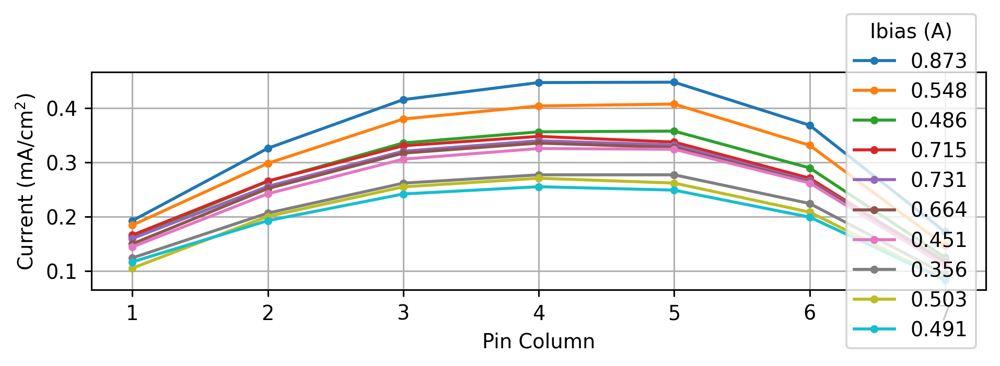

In [69]:
import matplotlib.pyplot as plt
plt.figure(dpi=276, figsize=(8,2))
for i, slice in enumerate(df_01Dec.head(10).CurrentSlice):
    if len(slice) == 5:
        offset = 2
    else:
        offset = 1
    x = np.arange(offset, offset+len(slice))
    label = df_01Dec.iloc[i].Ibias
    plt.plot(x, slice, '.-', label = label)
plt.xlabel('Pin Column')
plt.ylabel('Current (mA/cm$^2$)')
plt.legend(title = 'Ibias (A)', loc='right')
plt.grid()
plt.show()

### 2nd December

Tube connected to a power supply. Doesn't make much difference. See individual notebooks.


In [71]:
df_02Dec = df[df.date == 201202].sort_values(by=['IpinMax'], ascending=False)
df_02Dec

,date,time,IpinMax,CurrentSlice,pressure,Vbias,Ibias,Varc,Iarc,Vext,...,currents,note,Ve1,Ie1,Ve2,Ie2,Ipfs_tube,Vpfs_tube,Vtube,Itube
159,201202,160939,0.44410,"[0.1983, 0.326, 0.4096, 0.4413, 0.4441, 0.3305...",0.00024,125,1.030,71.0,5.05,NaN,...,"[[0.01485, 0.07525000000000001, 0.1892, 0.2251...",Tube referenced to PFS Vbias.,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
156,201202,141555,0.44330,"[0.192, 0.32120000000000004, 0.4097, 0.439, 0....",0.00030,125,0.657,69.1,6.07,NaN,...,"[[0.01314, 0.07563, 0.1699, 0.2016, 0.1584, 0....",Tube referenced to PFS Vbias.,NaN,NaN,NaN,NaN,NaN,NaN,93.0,0.19
162,201202,161745,0.43910,"[0.1923, 0.3235, 0.40490000000000004, 0.4374, ...",0.00024,125,0.983,73.6,5.03,NaN,...,"[[0.014910000000000001, 0.07352, 0.18710000000...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
158,201202,141833,0.43800,"[0.19160000000000002, 0.32280000000000003, 0.4...",0.00030,125,0.670,69.1,6.08,NaN,...,"[[0.012770000000000002, 0.07595, 0.1721, 0.203...",Tube referenced to PFS Vbias.,NaN,NaN,NaN,NaN,NaN,NaN,300.0,0.24
161,201202,161442,0.36510,"[0.1573, 0.26890000000000003, 0.3373, 0.365100...",0.00027,125,0.825,75.0,3.94,NaN,...,"[[0.013410000000000002, 0.06365000000000001, 0...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
157,201202,141717,0.32530,"[0.11810000000000001, 0.2243, 0.2918, 0.323, 0...",0.00030,125,0.477,69.1,6.08,NaN,...,"[[0.002624, 0.03203, 0.09534000000000001, 0.11...","Tube referenced to PFS Vbias. DC Fail. Can""t g...",NaN,NaN,NaN,NaN,NaN,NaN,52.0,0.02
160,201202,161214,0.31390,"[0.1343, 0.23190000000000002, 0.2904, 0.3139, ...",0.00030,125,0.725,75.0,3.15,NaN,...,"[[0.0152, 0.057420000000000006, 0.132, 0.1501,...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
155,201202,140853,0.18510,"[0.06189000000000001, 0.13090000000000002, 0.1...",0.00026,125,0.284,69.1,2.89,NaN,...,"[[0.0012389999999999999, 0.01156, 0.0490300000...",Tube referenced to PFS Vbias.,NaN,NaN,NaN,NaN,NaN,NaN,300.0,0.13
154,201202,140819,0.18500,"[0.06182000000000001, 0.1307, 0.1709, 0.185, 0...",0.00026,125,0.285,69.1,2.89,NaN,...,"[[0.001249, 0.01153, 0.048960000000000004, 0.0...",Tube referenced to PFS Vbias.,NaN,NaN,NaN,NaN,NaN,NaN,275.0,0.13
148,201202,140014,0.18440,"[0.0618, 0.1295, 0.1696, 0.1844, 0.1831, 0.144...",0.00025,125,0.287,69.1,2.90,NaN,...,"[[0.0012749999999999999, 0.011380000000000001,...",Tube referenced to PFS Vbias.,NaN,NaN,NaN,NaN,NaN,NaN,125.0,0.12


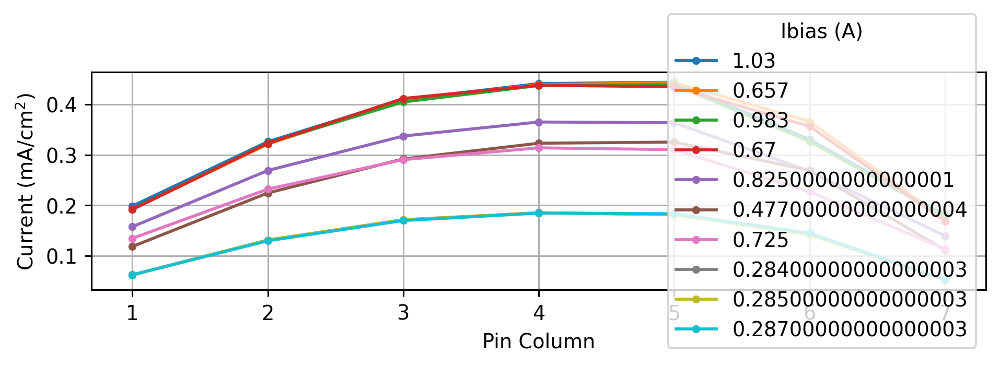

In [72]:
import matplotlib.pyplot as plt
plt.figure(dpi=276, figsize=(8,2))
for i, slice in enumerate(df_02Dec.head(10).CurrentSlice):
    if len(slice) == 5:
        offset = 2
    else:
        offset = 1
    x = np.arange(offset, offset+len(slice))
    label = df_02Dec.iloc[i].Ibias
    plt.plot(x, slice, '.-', label = label)
plt.xlabel('Pin Column')
plt.ylabel('Current (mA/cm$^2$)')
plt.legend(title = 'Ibias (A)', loc='right')
plt.grid()
plt.show()

On the above graph, some results are with the tube and some are without. There's no real difference.

In [74]:
df_02Dec.Ibase

159    33.60
156    26.35
162    29.50
158    25.98
161    27.30
157    19.79
160    25.80
155    13.90
154    13.86
148    13.51
147    13.44
153    13.64
146    13.70
152    13.53
145    13.72
149    13.32
151    13.37
150    13.32
144    13.55
143    13.22
142    12.39
141    10.62
140     7.73
139     6.99
Name: Ibase, dtype: float64

In [83]:

df_09Dec = df[df.date == 201209].sort_values(by=['IpinMax'], ascending=False)
df_09Dec

,date,time,IpinMax,CurrentSlice,pressure,Vbias,Ibias,Varc,Iarc,Vext,...,currents,note,Ve1,Ie1,Ve2,Ie2,Ipfs_tube,Vpfs_tube,Vtube,Itube
172,201209,154247,0.22150,"[0.09745000000000001, 0.16920000000000002, 0.2...",0.00020,100,0.505,150.0,3.76,NaN,...,"[[0.008067999999999999, 0.032080000000000004, ...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
171,201209,154154,0.19280,"[0.08163000000000001, 0.1454, 0.1849, 0.1228, ...",0.00020,100,0.440,140.0,3.50,NaN,...,"[[0.008763, 0.031070000000000004, 0.0903500000...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
170,201209,154118,0.16770,"[0.06733, 0.12290000000000001, 0.1583, 0.10740...",0.00020,100,0.387,130.0,3.28,NaN,...,"[[0.01026, 0.03229, 0.07056000000000001, 0.082...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
169,201209,153958,0.15290,"[0.05988, 0.11, 0.14400000000000002, 0.1034, 0...",0.00021,100,0.350,120.0,3.10,NaN,...,"[[0.01064, 0.0251, 0.059390000000000005, 0.071...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
168,201209,153859,0.12790,"[0.0408, 0.08752, 0.1187, 0.0843, 0.1279, 0.09...",0.00020,100,0.277,110.0,2.90,NaN,...,"[[-0.0003341, 0.00534, 0.0347, 0.0457500000000...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
173,201209,154557,0.11550,"[0.035780000000000006, 0.08036, 0.110400000000...",0.00020,100,0.260,149.0,2.10,NaN,...,"[[-0.0012469999999999998, 0.003065, 0.02816, 0...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
167,201209,153757,0.11300,"[0.033690000000000005, 0.07534, 0.1034, 0.0793...",0.00020,100,0.243,100.0,2.70,NaN,...,"[[-1.8900000000000002e-05, 0.00388599999999999...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
166,201209,153713,0.10160,"[0.028030000000000003, 0.06703, 0.09092, 0.078...",0.00020,100,0.216,90.0,2.51,NaN,...,"[[0.0002816, 0.003137, 0.020790000000000003, 0...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
165,201209,153613,0.09609,"[0.024880000000000003, 0.06221000000000001, 0....",0.00018,100,0.204,90.0,2.40,NaN,...,"[[0.0002584, 0.002647, 0.017830000000000002, 0...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
164,201209,153515,0.08812,"[0.021290000000000003, 0.0562, 0.07767, 0.0720...",0.00020,100,0.184,80.0,2.27,NaN,...,"[[0.0004608, 0.0023929999999999997, 0.01485, 0...",,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


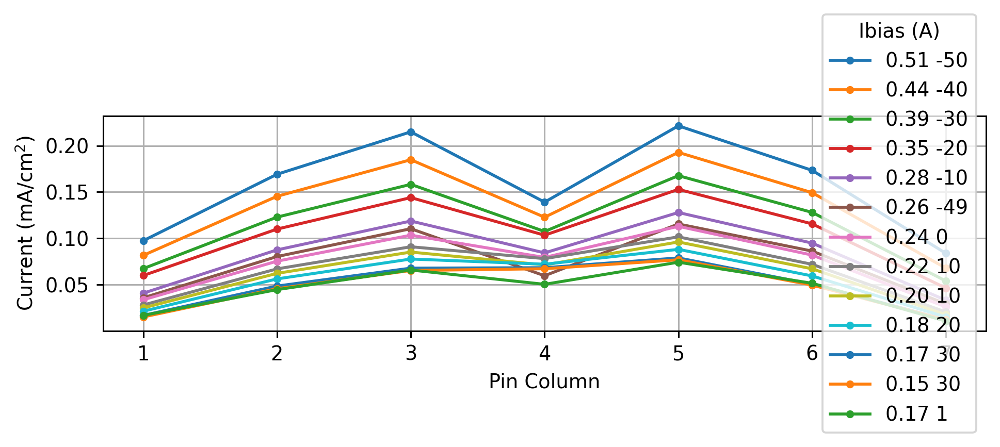

In [98]:
import matplotlib.pyplot as plt
plt.figure(dpi=276, figsize=(8,2))
for i, slice in enumerate(df_09Dec.CurrentSlice):
    if len(slice) == 5:
        offset = 2
    else:
        offset = 1
    x = np.arange(offset, offset+len(slice))
    label = f'{df_09Dec.iloc[i].Ibias:.2f} {int(df_09Dec.iloc[i].Vbias-df_09Dec.iloc[i].Varc)}'
    plt.plot(x, slice, '.-', label = label)
plt.xlabel('Pin Column')
plt.ylabel('Current (mA/cm$^2$)')
plt.legend(title = 'Ibias (A)', loc='right')
plt.grid()
plt.show()